# <center>Web Traffic Analysis</center>
## <center>(Santa Monica Government Websites)</center>

<b>Project Members:</b>

<b>Member 1:</b>

Student Name: Rahul Purushottam Gaonkar

Student Netid: rpg283

<b>Member 2:</b>

Student Name: Bhushan Manohar Newalkar

Student Netid: bmn258    
***

In [2]:
# Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import acf  
from statsmodels.tsa.stattools import pacf
from scipy.stats.stats import pearsonr
from statsmodels.graphics.api import qqplot
from statsmodels.tsa.stattools import adfuller
from sklearn.model_selection import TimeSeriesSplit
import matplotlib.patheffects as path_effects
import statsmodels.tsa.seasonal as sd
import statsmodels.api as sm
import statsmodels.tsa.statespace.sarimax as sari_max 
from scipy import stats
import seaborn as sns
from sklearn import preprocessing
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [3]:
# Loading and Preparing data
def datasetPrepare(dataset_name):
    df = pd.read_csv(dataset_name)
    df = df[['date','domain','page','page_title','pageviews','avg_time_on_page','avg_page_load_time','bounces']]
    df['date'] = pd.to_datetime(df['date'])
# Handling inconsistencies in domain name    
    df[~df['domain'].str.contains("localhost")]
    df['domain'] = df['domain'].map(lambda x: x.lstrip('www.'))
    df = df.apply(lambda x: x.str.strip() if x.dtype == "object" else x)
    return df

In [4]:
df = datasetPrepare("Web_Analytics.csv")

In [5]:
# Time Series Analysis for pageviews forecasting of top 20 web pages for advertising purpose
# Get top 20 web pages based on page views
def get_top_20_pages(df):
    df_top_20_pages_data = df[['date','domain','page','pageviews']]
    df_top_20_pages = df_top_20_pages_data.groupby(['domain','page'])['pageviews'].sum().to_frame().sort_values(by='pageviews',ascending=False).reset_index()
    df_top_20_pages = df_top_20_pages.head(21)
    df_top_20_pages = df_top_20_pages.drop('pageviews',1)
    df_top_20_pages = pd.merge(df_top_20_pages_data, df_top_20_pages, on=['domain','page'])
# General Handling of inconsistencies(Duplicate values)    
    df_top_20_pages = df_top_20_pages.groupby(['date','domain','page'])['pageviews'].sum().to_frame().reset_index() 
# Dropping a page as it has a lot of page views for each day with value 0
    df_top_20_pages = df_top_20_pages[~((df_top_20_pages['domain']=='bigbluebus.com') & (df_top_20_pages['page']=='/default.aspx'))]
    return df_top_20_pages

In [6]:
df_top_20_pages = get_top_20_pages(df) 
# Top 20 web page names
df_top_20_pages_names = df_top_20_pages.groupby(['domain','page']).size().to_frame().reset_index().drop(0,1)

In [7]:
# Time Series Data of Single Page from the Top 20 pages selected 
def page_data(page_number): 
    pagedf = df_top_20_pages[(df_top_20_pages['domain'] == df_top_20_pages_names['domain'].iloc[page_number]) & (df_top_20_pages['page'] == df_top_20_pages_names['page'].iloc[page_number])]
    pagedf = pagedf[['date','pageviews']]    
    pagedf.set_index('date', inplace=True)
    pagedf.index.name=None 
    # Filling in Missing Date Values for the Page (Considering data from '01-01-2017' to '11-10-2018')
    date_range = pd.date_range('01-01-2017', '11-10-2018')
    pagedf = pagedf.reindex(date_range, fill_value=pagedf['pageviews'].mean())
    return pagedf

In [8]:
# Collecting confounding variable data('avg_time_on_page','avg_page_load_time','bounces') of Single Page from the top 20 pages selected 
def page_confounder_variable_data(page_number):
    pagedf = df[(df['domain'] == df_top_20_pages_names['domain'].iloc[page_number]) & (df['page'] == df_top_20_pages_names['page'].iloc[page_number])]
# General Handling of missing values and inconsistencies(Duplicate values)
    pagedf.fillna(pagedf.mean(), inplace=True)
    pagedf = pagedf.groupby(['date','domain','page'])['pageviews','avg_time_on_page','avg_page_load_time','bounces'].apply(lambda x : x.astype(int).sum()).reset_index() 
    pagedf.set_index('date', inplace=True)
    pagedf.index.name=None 
    # Filling in Missing Date Values for the Page (Considering data from '01-01-2017' to '11-10-2018')
    date_range = pd.date_range('01-01-2017', '11-10-2018')
    pagedf = pagedf.reindex(date_range, fill_value=np.nan)
    pagedf.fillna(pagedf.mean(), inplace=True)
    pagedf = pagedf[['pageviews','avg_time_on_page','avg_page_load_time','bounces']]
    return pagedf    

In [9]:
# Displaying Scatter Plot and Heat Map to visualize the correlation of confounding variables with page views of the top 20 web pages and with each other too.
def scatterPlotConfoundingVariable(page_number):
    pagedf = page_confounder_variable_data(page_number)
    fig1 = plt.subplot(231)
    fig1.figure.set_size_inches(20,10)
    plt.title('Scatter Plot : Avg Time On Page vs PageViews')
    plt.xlabel('Avg Time On Page')
    plt.ylabel('PageViews')
    plt.scatter(pagedf['avg_time_on_page'], pagedf['pageviews'], s=50, c="red")
    fig2 = plt.subplot(232)
    fig2.figure.set_size_inches(20,10)
    plt.title('Scatter Plot : Avg Page Load Time vs PageViews')
    plt.xlabel('Avg Page Load Time')
    plt.ylabel('PageViews')
    plt.scatter(pagedf['avg_page_load_time'], pagedf['pageviews'], s=50, c="red")
    fig3 = plt.subplot(233)
    fig3.figure.set_size_inches(20,10)
    plt.title('Scatter Plot : Bounces vs PageViews')
    plt.xlabel('Bounces')
    plt.ylabel('PageViews')
    plt.scatter(pagedf['bounces'], pagedf['pageviews'], s=50, c="red")
    plt.subplot(235)
    plt.title('Correlation Matrix Plot')
# Calculating Pearson correlation coefficient (Positive value indicates positive relationship and negative value indicates negative relationship) 
    correlation_df = pd.DataFrame(columns=['feature', 'pageviews', 'avg_time_on_page', 'avg_page_load_time', 'bounces'])
    correlation_df = correlation_df.append(pd.DataFrame([['pageviews', pearsonr(pagedf['pageviews'], pagedf['pageviews'])[0], pearsonr(pagedf['pageviews'], pagedf['avg_time_on_page'])[0], pearsonr(pagedf['pageviews'], pagedf['avg_page_load_time'])[0],pearsonr(pagedf['pageviews'], pagedf['bounces'])[0]]], columns = ['feature', 'pageviews', 'avg_time_on_page', 'avg_page_load_time', 'bounces']))
    correlation_df = correlation_df.append(pd.DataFrame([['avg_time_on_page', pearsonr(pagedf['avg_time_on_page'], pagedf['pageviews'])[0], pearsonr(pagedf['avg_time_on_page'], pagedf['avg_time_on_page'])[0], pearsonr(pagedf['avg_time_on_page'], pagedf['avg_page_load_time'])[0],pearsonr(pagedf['avg_time_on_page'], pagedf['bounces'])[0]]], columns = ['feature', 'pageviews', 'avg_time_on_page', 'avg_page_load_time', 'bounces']))
    correlation_df = correlation_df.append(pd.DataFrame([['avg_page_load_time', pearsonr(pagedf['avg_page_load_time'], pagedf['pageviews'])[0], pearsonr(pagedf['avg_page_load_time'], pagedf['avg_time_on_page'])[0], pearsonr(pagedf['avg_page_load_time'], pagedf['avg_page_load_time'])[0],pearsonr(pagedf['avg_page_load_time'], pagedf['bounces'])[0]]], columns = ['feature', 'pageviews', 'avg_time_on_page', 'avg_page_load_time', 'bounces']))
    correlation_df = correlation_df.append(pd.DataFrame([['bounces', pearsonr(pagedf['bounces'], pagedf['pageviews'])[0], pearsonr(pagedf['bounces'], pagedf['avg_time_on_page'])[0], pearsonr(pagedf['bounces'], pagedf['avg_page_load_time'])[0],pearsonr(pagedf['bounces'], pagedf['bounces'])[0]]], columns = ['feature', 'pageviews', 'avg_time_on_page', 'avg_page_load_time', 'bounces']))
    correlation_df.set_index('feature', inplace=True)
    correlation_df.index.name=None
    sns.heatmap(correlation_df, annot=True, cmap='BrBG', center=0, square=True)

In [10]:
# Displaying Time Series Plot of top 20 web Pages 
def display_pages_plot(page_number): 
    pagedf = page_data(page_number)
    ax = fig.add_subplot(10,2,page_number+1)
    plot = pagedf.pageviews.plot(ax=ax,figsize=(20,40), title= 'Page URL: '+df_top_20_pages_names['domain'].iloc[page_number]+df_top_20_pages_names['page'].iloc[page_number], fontsize=14)
    plot.set_xlabel("Date")
    plot.set_ylabel("PageViews")

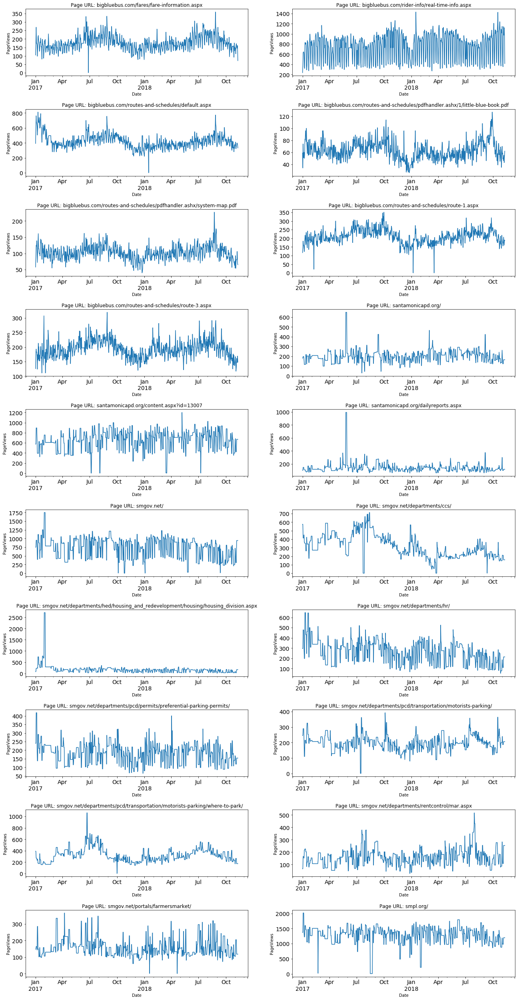

In [11]:
fig = plt.figure(figsize=[100,100])
for i in range(20):
    display_pages_plot(i)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5,wspace=0.20)    
plt.show()

We can visually access the stationarity of the time series of page views for different pages in the above plots by identifying any trend or seasonal component in the time series.

Another method for visualizing the stationarity of the time series is by calculating the summary statistics like rolling mean and rolling standard deviation and checking if they are consistent (constant) over time.

We can also use durbin-watson statistic to test the stationarity of the time series.The durbin-watson statistic has a value between 0-4 where a value of 2 indicates no auto-correlation,a value between 0-2 indicates positive auto-correlation and a value between 2-4 indicates negative auto-correlation

<b>We used the statsmodels.tsa.seasonal.seasonal_decompose package to find the seasonal component in the time series data and found out that the seasonal difference should be taken based on week i.e. 7 days</b>  

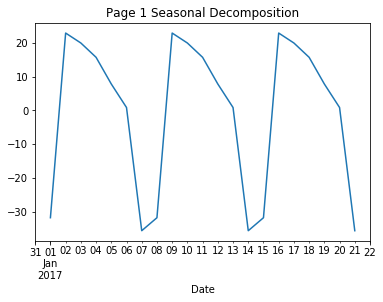

In [12]:
# Showing the seasonal component for Page 1 (Page URL: bigbluebus.com/fares/fare-information.aspx)
# We can see that the pattern is repeated after every 7 days i.e. a week
decomposition = sd.seasonal_decompose(page_data(0).pageviews)
seasonal = decomposition.seasonal.head(21).plot(title='Page 1 Seasonal Decomposition')
xlabel = seasonal.set_xlabel("Date")

In [13]:
# Perform first difference of seasonal difference of time series data of a single page from the top 20 pages
def first_difference_seasonal_difference(pagetimeseries):    
    pagetimeseries['first_difference'] = pagetimeseries.pageviews - pagetimeseries.pageviews.shift(1)
    pagetimeseries['seasonal_first_difference'] = pagetimeseries.first_difference - pagetimeseries.first_difference.shift(7)
    pagetimeseries.drop(['pageviews', 'first_difference'], axis=1,inplace=True)  
    pagetimeseries.rename(columns={'seasonal_first_difference':'pageviews'}, inplace=True)
    pagetimeseries.dropna(inplace=True)
    return pagetimeseries    

In [14]:
# Checking Stationarity of Time Series Plot of Pages using Rolling Mean, Rolling Standard Deviation and Durbin-Watson test
# 'perform_differencing' variable should be True if we are performing first difference of seasonal difference of the time series data else should be false 
def display_time_series_stationarity_statistic(page_number,perform_differencing):
    pagetimeseries = page_data(page_number)
    if(perform_differencing):
        pagetimeseries = first_difference_seasonal_difference(pagetimeseries)
    # Determing rolling statistics
    rollingmean = pagetimeseries.rolling(window=7).mean()
    rollingstd = pagetimeseries.rolling(window=7).std()
    
    # Renaming Columns of all Dataframes as they will be used as legends while plotting the time series
    pagetimeseries.rename(columns={'pageviews':'original'}, inplace=True)
    rollingmean.rename(columns={'pageviews':'rollingmean'}, inplace=True)
    rollingstd.rename(columns={'pageviews':'rollingstd'}, inplace=True)
    
    # Perform Durbin Watson test:
    dwscore=sm.stats.durbin_watson(pagetimeseries)
    
    # Plot rolling statistics:
    ax = fig.add_subplot(10,2,page_number+1)
    pagetimeseries.plot(ax=ax,figsize=(20,40), title= 'Page URL: '+df_top_20_pages_names['domain'].iloc[page_number]+df_top_20_pages_names['page'].iloc[page_number]+' (Durbin Watson Test Score: %0.2f' %dwscore+')', fontsize=14)
    rollingmean.plot(ax=ax,figsize=(20,40), title= 'Page URL: '+df_top_20_pages_names['domain'].iloc[page_number]+df_top_20_pages_names['page'].iloc[page_number]+' (Durbin Watson Test Score: %0.2f' %dwscore+')', fontsize=14)    
    plot = rollingstd.plot(ax=ax,figsize=(20,40), title= 'Page URL: '+df_top_20_pages_names['domain'].iloc[page_number]+df_top_20_pages_names['page'].iloc[page_number]+' (Durbin Watson Test Score: %0.2f' %dwscore+')', fontsize=14)
    plot.set_xlabel("Date")
    plot.set_ylabel("PageViews")
    plot.legend(loc='upper right')

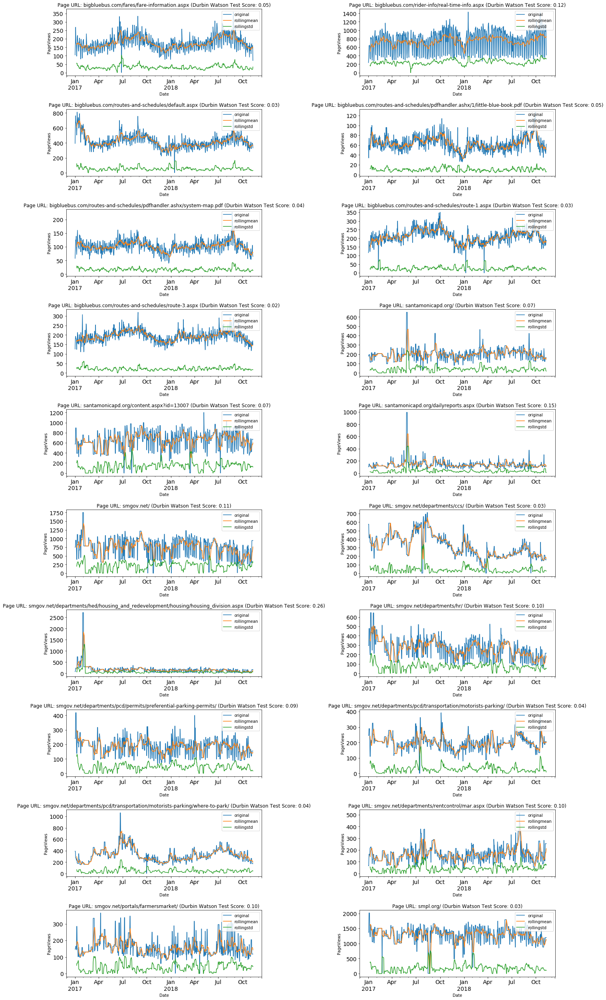

In [15]:
fig = plt.figure(figsize=[100,100])
for i in range(20):
# We are not performing the differencing operation so we pass in False to the below function
    display_time_series_stationarity_statistic(i,False)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5,wspace=0.5)    
plt.show()

From the above plots, we can infer that the time series of the top 20 pages are not stationary and contain trend and seasonality.

So, the first step in time series modeling for forecasting page views is to make the time series stationary by removing trend and seasonality.

One method to make the time series stationary is to perform differencing of the time series data.
We will try to perform first difference of seasonal difference of the time series data and check if the time series become stationary after the differencing operation 

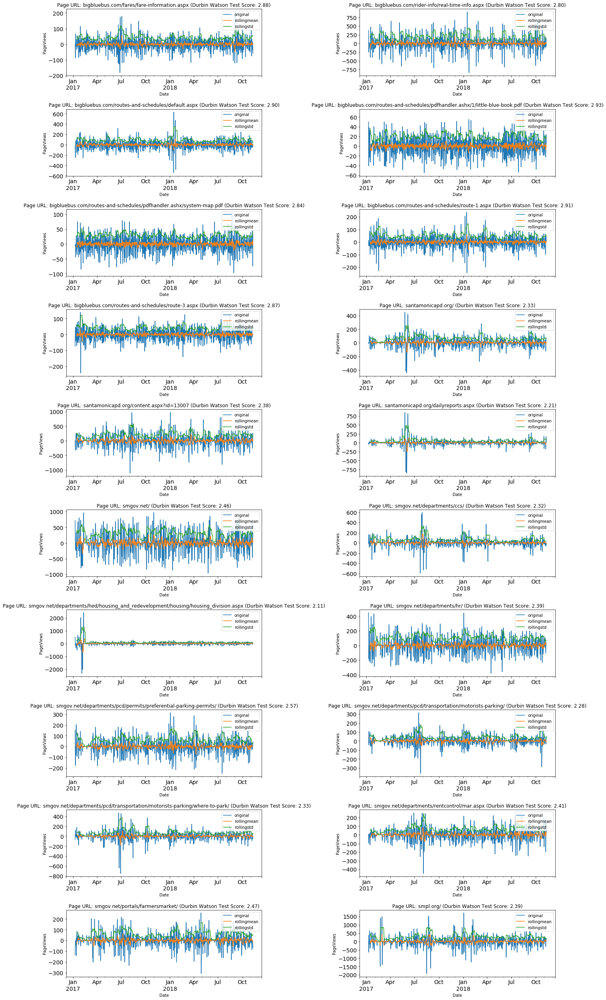

In [16]:
fig = plt.figure(figsize=[100,100])
for i in range(20):
# We are performing the differencing operation so we pass in True to the below function    
    display_time_series_stationarity_statistic(i,True)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5,wspace=0.5)    
plt.show()

As we can see from the above plots that we have stabilized the rolling mean for the time series of the top 20 pages by performing first difference of seasonal difference of the time series data. This is a significant improvement towards making the time series stationary.

The next step is to identify the model parameters(AR, MA,SAR,SMA) by visual inspection of the plotted acf and pacf. The AR,MA,SAR,SMA terms of the SARIMAX model will further handle any mild under difference or over difference of the time series data. 

In [17]:
# Plotting ACF and PACF of the top 20 Pages Time Series Plot
def plot_ACF_PACF(page_number,grid_position):    
    pagetimeseries = page_data(page_number)
    pagetimeseries = first_difference_seasonal_difference(pagetimeseries)
    ax1 = fig.add_subplot(20,2,grid_position+1)
    fig1 = sm.graphics.tsa.plot_acf(pagetimeseries, lags=40, ax=ax1)
    fig1.set_size_inches(20, 70)
    ax1.set_xlabel("Lags")
    ax1.set_title('Page URL: '+df_top_20_pages_names['domain'].iloc[page_number]+df_top_20_pages_names['page'].iloc[page_number]+' (Autocorrelation)')
    ax2 = fig.add_subplot(20,2,grid_position+2)
    fig2 = sm.graphics.tsa.plot_pacf(pagetimeseries, lags=40, ax=ax2)
    fig2.set_size_inches(20, 70)
    ax2.set_xlabel("Lags")
    ax2.set_title('Page URL: '+df_top_20_pages_names['domain'].iloc[page_number]+df_top_20_pages_names['page'].iloc[page_number]+' (Partial Autocorrelation)')

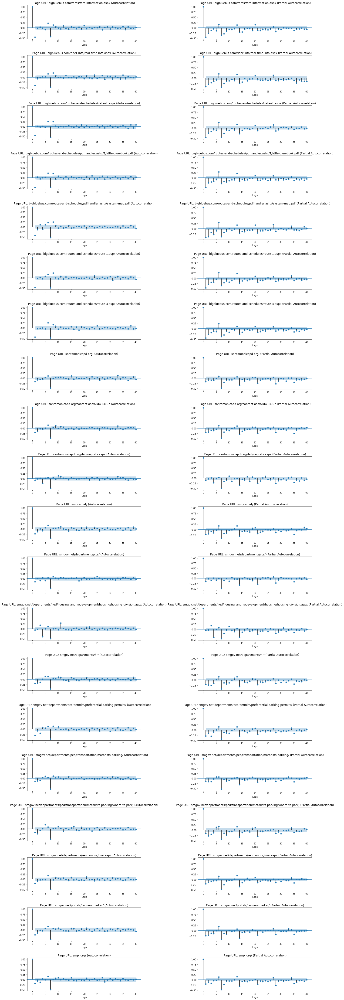

In [18]:
fig = plt.figure(figsize=[100,100])
grid_pos = 0
for i in range(20):    
    plot_ACF_PACF(i,grid_pos)
    grid_pos += 2 
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5,wspace=0.5)    
plt.show()

Some rules of thumb to recall to identify the model parameters (AR(p),MA(q)) of the SARIMAX model by visual inspection of ACF and PACF Plot:<br>
Rule 1: If the ACF shows exponential decay, the PACF has a spike at lag 1, and no correlation for other lags, then use one autoregressive (p)parameter <br>
Rule 2: If the ACF shows a sine-wave shape pattern or a set of exponential decays, the PACF has spikes at lags 1 and 2, and no correlation for other lags, then use two autoregressive (p) parameters. <br>
Rule 3: If the ACF has a spike at lag 1, no correlation for other lags, and the PACF damps out exponentially, then use one moving average (q) parameter. <br>
Rule 4: If the ACF has spikes at lags 1 and 2, no correlation for other lags, and the PACF has a sine-wave shape pattern or a set of exponential decays, then use two moving average (q) parameter.<br>
Rule 5: If the ACF shows exponential decay starting at lag 1, and the PACF shows exponential decay starting at lag 1, then use one autoregressive (p) and one moving average (q) parameter.<br>

Some rules to recall to identify the seasonal model parameters (SAR(P),SMA(Q)) of the SARIMAX model by visual inspection of ACF and PACF Plot:<br>
Rule 1: If the ACF value is negative at seasonal lags (i.e. lag 7,14,21 for weekly seasonal pattern), then add a seasonal MA term(Q) to the model.<br> 
Rule 2: If the ACF value is positive at seasonal lags (i.e. lag 7,14,21 for weekly seasonal pattern), then add a seasonal AR term(P) to the model.
Rule 3: If the PACF value is negative at seasonal lags (i.e. lag 7,14,21 for weekly seasonal pattern), then add a seasonal AR term(P) to the model.<br> 
Rule 4: If the PACF value is positive at seasonal lags (i.e. lag 7,14,21 for weekly seasonal pattern), then add a seasonal MA term(Q) to the model.<br>

The AR,MA,SAR and SMA terms of the SARIMAX model for the time series modeling of the top 20 web pages are as follows:
1. Page URL: bigbluebus.com/fares/fare-information.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
2. Page URL: bigbluebus.com/rider-info/real-time-info.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
3. Page URL: bigbluebus.com/routes-and-schedules/default.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
4. Page URL: bigbluebus.com/routes-and-schedules/pdfhandler.ashx/1/little-blue-book.pdf<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
5. Page URL: bigbluebus.com/routes-and-schedules/pdfhandler.ashx/system-map.pdf<br>
<b>AR Term: 0 MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
6. Page URL: bigbluebus.com/routes-and-schedules/route-1.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
7. Page URL: bigbluebus.com/routes-and-schedules/route-3.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
8. Page URL: santamonicapd.org/<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
9. Page URL: santamonicapd.org/content.aspx?id=13007<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
10. Page URL: santamonicapd.org/dailyreports.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
11. Page URL: smgov.net/<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
12. Page URL: smgov.net/departments/ccs/<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
13. Page URL: smgov.net/departments/hed/housing_and_redevelopment/housing/housing_division.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
14. Page URL: smgov.net/departments/hr/<br>
<b>AR Term: 0  MA Term: 2 SAR Term: 1 SMA Term: 1</b> 
15. Page URL: smgov.net/departments/pcd/permits/preferential-parking-permits/<br>
<b>AR Term: 0 MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
16. Page URL: smgov.net/departments/pcd/transportation/motorists-parking/<br>
<b>AR Term: 0  MA Term: 2 SAR Term: 1 SMA Term: 1</b> 
17. Page URL: smgov.net/departments/pcd/transportation/motorists-parking/where-to-park/<br>
<b>AR Term: 0  MA Term: 2 SAR Term: 1 SMA Term: 1</b> 
18. Page URL: smgov.net/departments/rentcontrol/mar.aspx<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
19. Page URL: smgov.net/portals/farmersmarket/<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 
20. Page URL: smpl.org/<br>
<b>AR Term: 0  MA Term: 1 SAR Term: 1 SMA Term: 1</b> 

We will use <b>TimeSeriesSplit Cross Validator</b> to train and validate the SARIMAX model in order to prevent the forward bias as well as promote generalization while training the SARIMAX model.

We will next plot the residuals generated after fitting the SARIMAX model,test the null hypothesis and construct a qq-plot to verify that the residuals come from a normal distribution i.e. white noise.  

We will also be evaluating our SARIMAX model using the forecast error metric i.e MAE and MFE.

<b>Mean absolute error:</b> The mean absolute error (MAE) value is computed as the average absolute error value. If MAE is zero the forecast is perfect. As compared to the mean squared error (MSE), this measure of fit “de-emphasizes” outliers (unique or rare large error values will affect the MAE less than the MSE.

<b>Mean Forecast Error(MFE, also known as Bias):</b> The MFE is the average error in the observations. A large positive MFE means that the forecast is undershooting the actual observations. A large negative MFE means the forecast is overshooting the actual observations. A value near zero is ideal, and generally a small value means a pretty good fit.

The MAE is a better indicator of fit than the MFE.

We are also analyzing the effect of the confounding variables on the page views of the web pages.General Assumptions regarding the confounding variables that can create a bias in time series modeling are as follows:

1. avg_page_load_time :<br>
The high value of average page load time can discourage the users to view the page in future  i.e. decreasing the number of future page views.


2. avg_time_on_page :<br> 
The high average time spent on the page indicates that the web page content is relevant to user interest and will encourage the user to view the page in future i.e. increasing the number of future page views. It can also help us to determine if user has been redirected to this page (by clicking on some advertisement) if the value of avg_time_on_page variable is low i.e. indicative of decreasing number of future page views.


3. bounces :<br>
The bounces variable can help you identify if a user or bot is viewing the web page and this will affect the number of page views. It can also help us to determine if user has been redirected to this page (by clicking on some advertisement). 

We will be visualizing the correlation of the confounding variables with the target variable i.e. the pageviews using the scatter plot.

We will be visualizing the Pearson's correlation coefficient of the confounding variables with the target variable i.e. the pageviews and also amongst themselves using heat map. 

In [19]:
# Mean Forecast Error
def mean_forecast_error(truth,forecast):
    diff = truth-forecast
    mean_forecast_error = np.mean(diff)
    return mean_forecast_error    

In [20]:
# Mean Absolute Error
def mean_absolute_error(truth,forecast):
    abs_diff = np.absolute(truth-forecast)
    mean_absolute_error = np.mean(abs_diff)
    return mean_absolute_error 

In [21]:
# Loading AR and MA terms for the top 20 web pages
arima_terms = [(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,1),(0,2),(0,1),(0,2),(0,2),(0,1),(0,1),(0,1)]
# SARIMAX Time Series modeling of the top 20 web pages
def arima_time_series_modeling(page_number):
    grid_position = 0
    pagetimeseries = page_data(page_number)
    pagetimeseries_cross_validator = TimeSeriesSplit(n_splits=10)
    pagetimeseries['forecast'] = np.nan
    AR_term = arima_terms[page_number][0]
    MA_term = arima_terms[page_number][1]
    iteration_number = 1
    text_box_position = 2
# Train and Test data split indices using TimeSeriesSplit Cross Validator     
    for train, test in pagetimeseries_cross_validator.split(pagetimeseries):
# Training SARIMAX model using the Train data indices        
        arima_model = sari_max.SARIMAX(pagetimeseries.pageviews[0:train.shape[0]-1], order=(AR_term,1,MA_term),seasonal_order=(1,1,1,7)).fit()
# Forecasting values based on Test data indices      
        forecast = arima_model.forecast(steps = test.shape[0])
        for index in range(len(forecast)):
            pagetimeseries.ix[train.shape[0]+index,'forecast'] = forecast[index]
        ax1 = fig.add_subplot(20,3,grid_position+1)
        ax1.set_xlabel('Date')
        ax1.set_ylabel('PageViews')
        ax1.set_title('Residual Plot : Iteration'+str(iteration_number))
        arima_model.resid.plot(figsize=(20, 100),ax=ax1)
        ax2 = fig.add_subplot(20,3,grid_position+2)
        ax2.set_title('qq-plot : Iteration'+str(iteration_number))
        qqplot(arima_model.resid, line='q', ax=ax2, fit=True).set_size_inches(20, 100)
        ax3 = fig.add_subplot(20,3,grid_position+3)
        ax3.set_xlabel('Date')
        ax3.set_ylabel('PageViews')
        ax3.set_title('Forecast v/s Actual Value : Iteration'+str(iteration_number))
        pagetimeseries.loc[pagetimeseries.iloc[train.shape[0]].name:pagetimeseries.iloc[train.shape[0]+test.shape[0]-1].name,['pageviews','forecast']].plot(figsize=(20, 100),ax=ax3).legend(loc='upper right')
        ax4 = fig.add_subplot(20,1,text_box_position)
# Testing null hypothesis: residuals comes from a normal distribution
# resid is the residuals
        truth_values = pagetimeseries['pageviews'].loc[pagetimeseries.iloc[train.shape[0]].name:pagetimeseries.iloc[train.shape[0]+test.shape[0]-1].name]
        forecast_values = pagetimeseries['forecast'].loc[pagetimeseries.iloc[train.shape[0]].name:pagetimeseries.iloc[train.shape[0]+test.shape[0]-1].name]
        info_text_display = str(stats.normaltest(arima_model.resid)) 
        info_text_display+="\nMean Absolute Error: %0.2f"%mean_absolute_error(truth_values,forecast_values)
        info_text_display+="\nMean Forecast Error: %0.2f"%mean_forecast_error(truth_values,forecast_values)    
        text = ax4.text(0.5,0.5,info_text_display,horizontalalignment='center',verticalalignment='top',color='red',style='italic',fontsize=10)
        text.set_path_effects([path_effects.Normal()])
        ax4.figure.set_size_inches(20,60)
        ax4.axis('off')
        grid_position+=6
        iteration_number+=1
        text_box_position+=2

### <center>Page URL: bigbluebus.com/fares/fare-information.aspx</center>

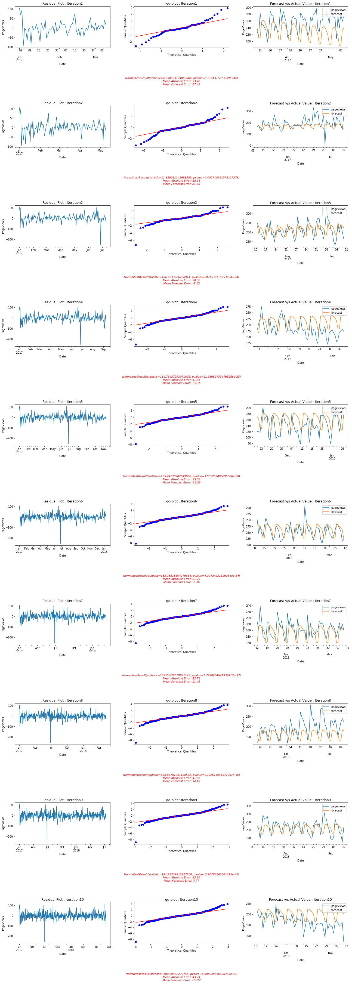

In [22]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(0)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

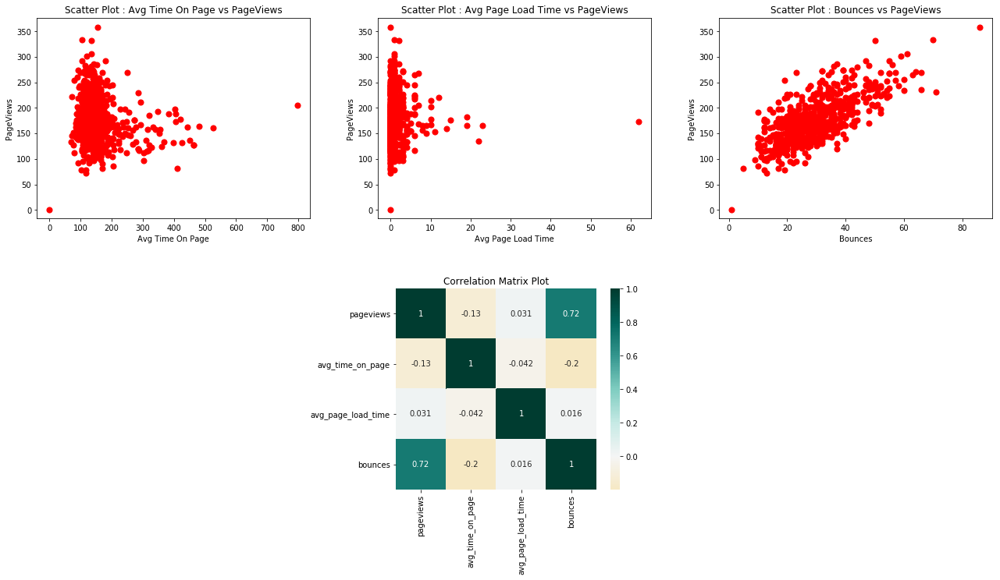

In [23]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(0)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: bigbluebus.com/rider-info/real-time-info.aspx</center>

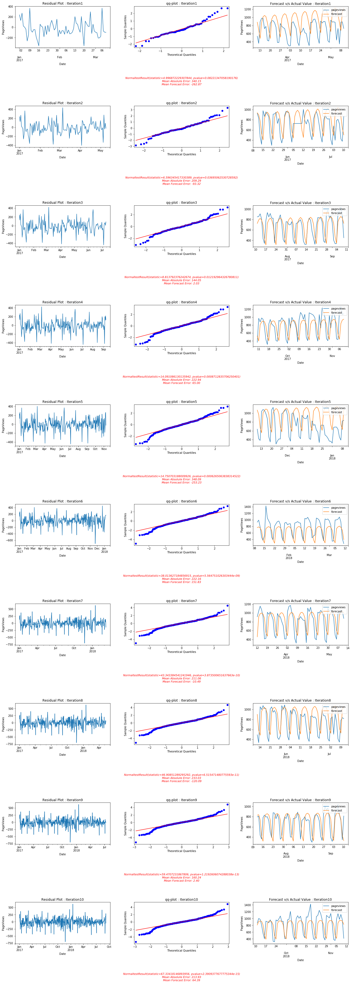

In [24]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

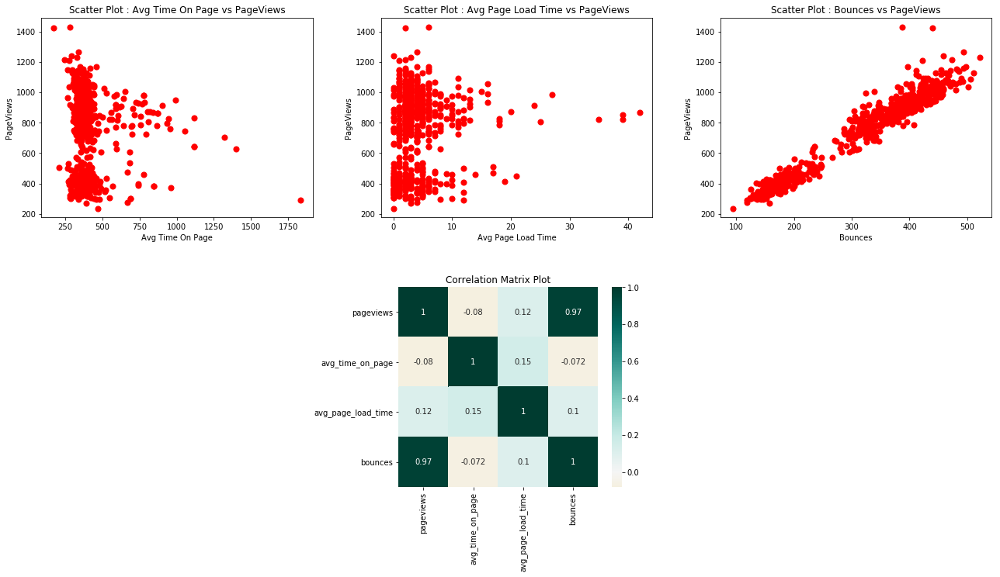

In [25]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: bigbluebus.com/routes-and-schedules/default.aspx</center>

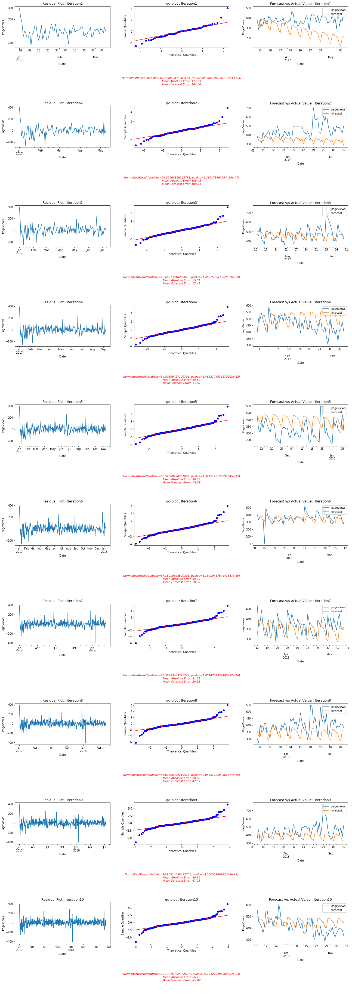

In [26]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(2)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

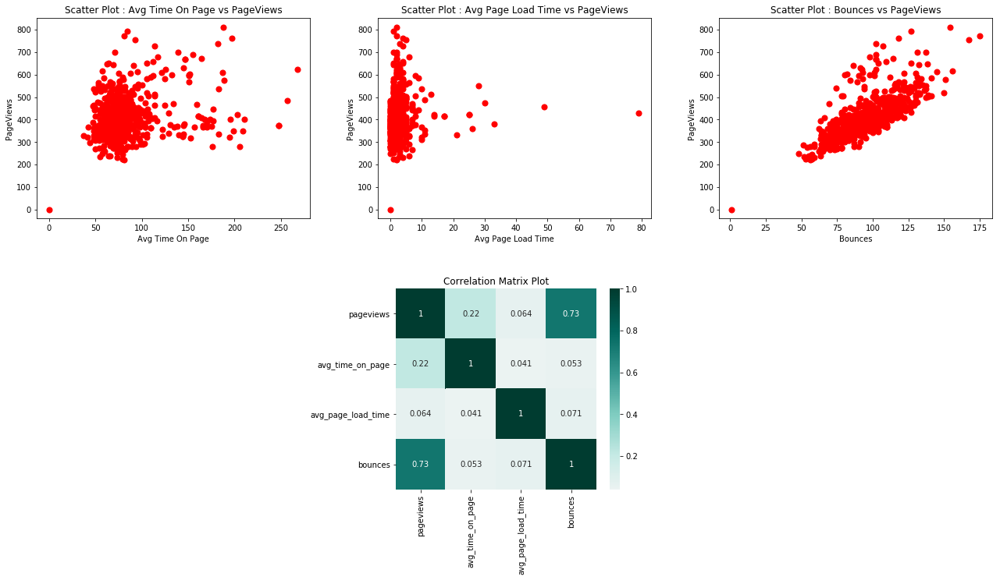

In [27]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(2)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: bigbluebus.com/routes-and-schedules/pdfhandler.ashx/1/little-blue-book.pdf</center>

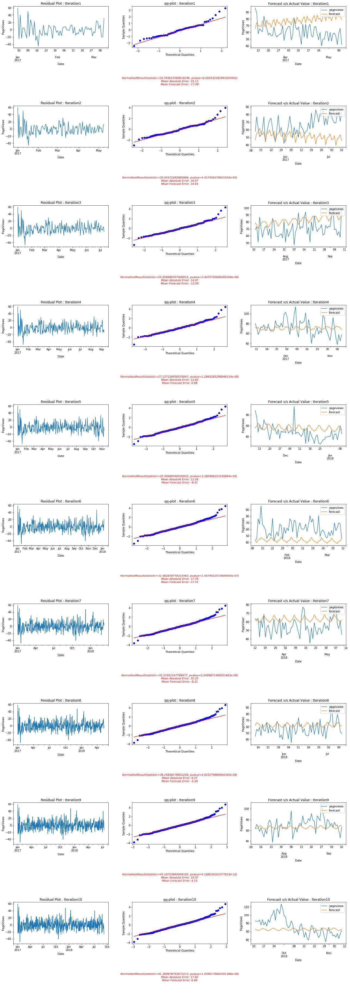

In [28]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(3)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

We didn't have data for the confounding variables('avg_time_on_page','avg_page_load_time','bounces') of this page to perform analysis of its effect on target variable i.e. pageviews

### <center>Page URL: bigbluebus.com/routes-and-schedules/pdfhandler.ashx/system-map.pdf</center>

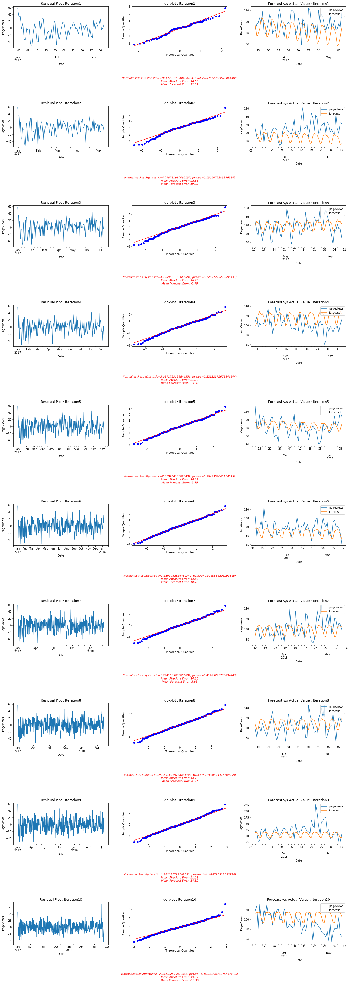

In [29]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(4)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

We didn't have data for the confounding variables ('avg_time_on_page','avg_page_load_time','bounces') of this page to perform analysis of its effect on target variable i.e. pageviews

### <center>Page URL: bigbluebus.com/routes-and-schedules/route-1.aspx</center>

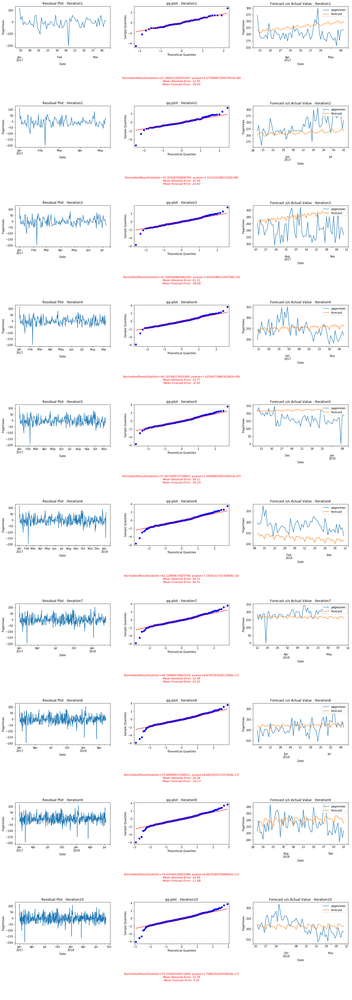

In [30]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(5)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

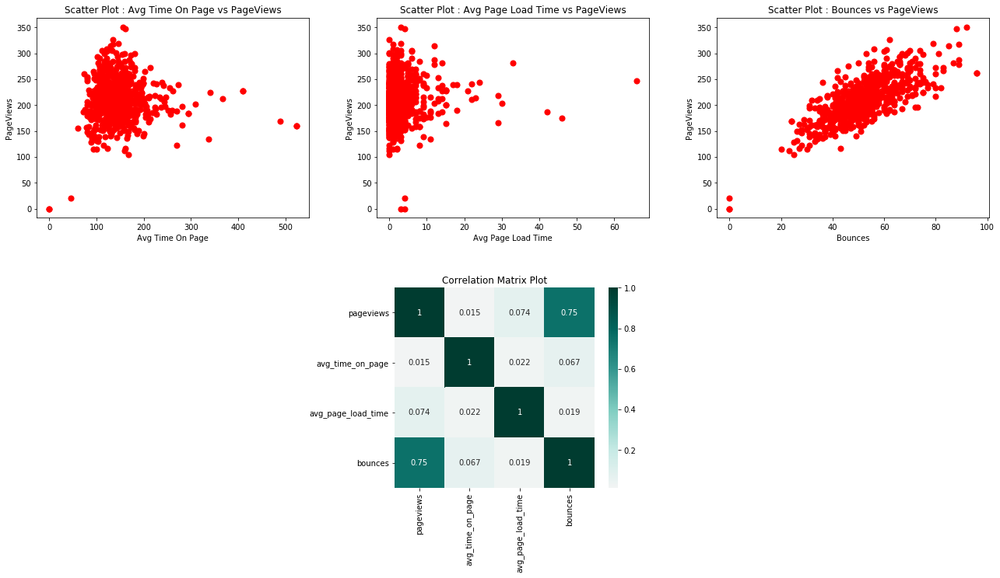

In [31]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(5)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: bigbluebus.com/routes-and-schedules/route-3.aspx</center>

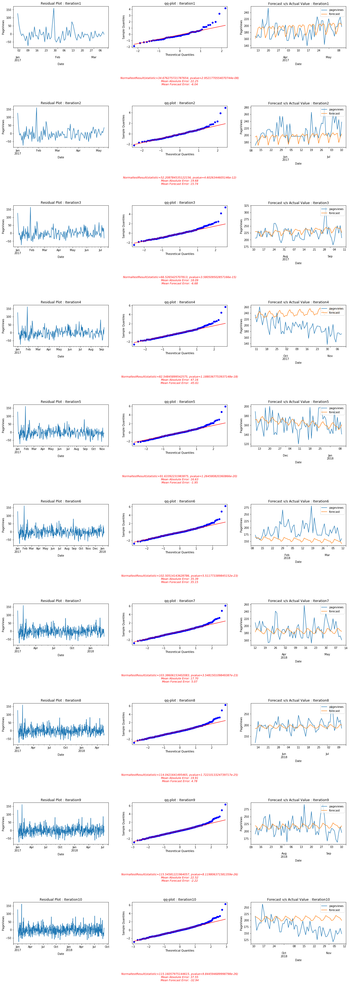

In [32]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(6)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

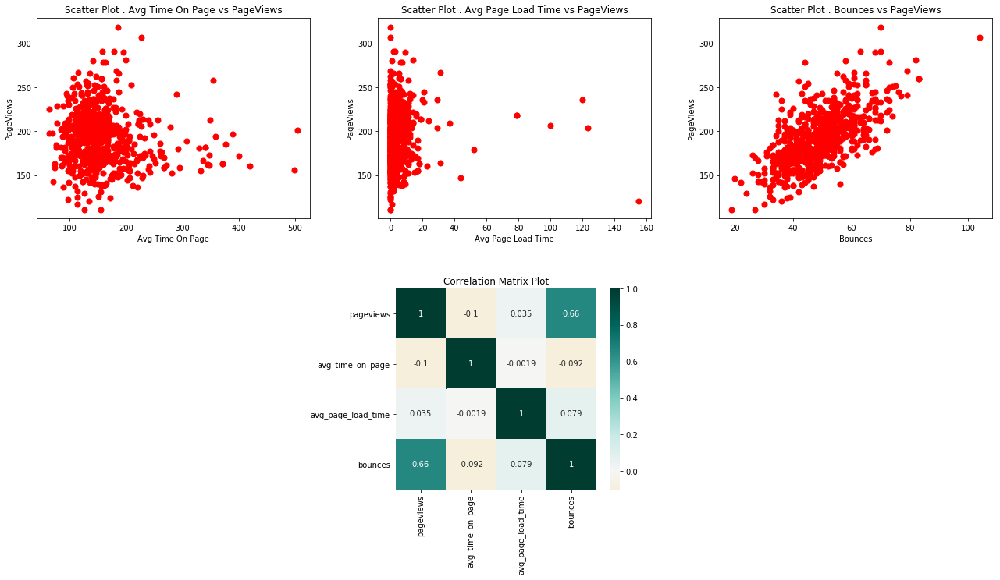

In [33]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(6)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: santamonicapd.org/</center>

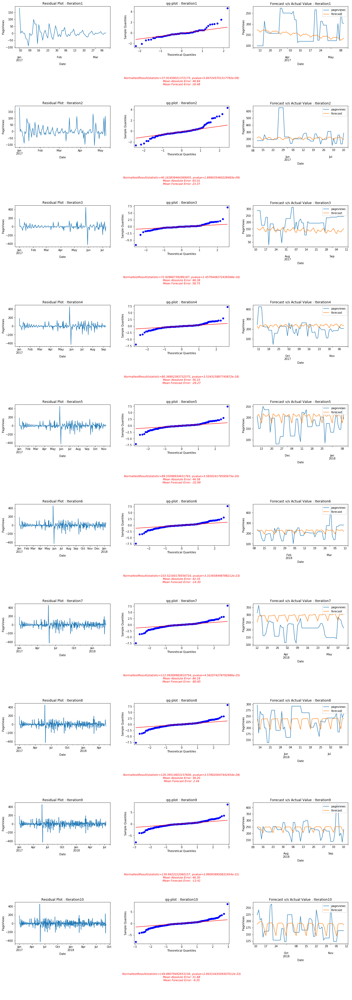

In [34]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(7)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

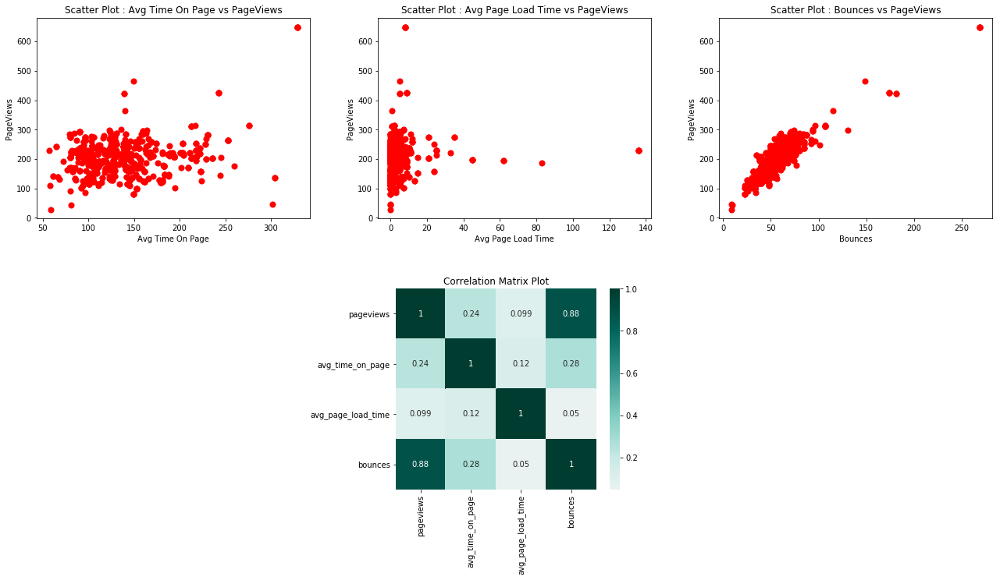

In [35]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(7)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: santamonicapd.org/content.aspx?id=13007</center>

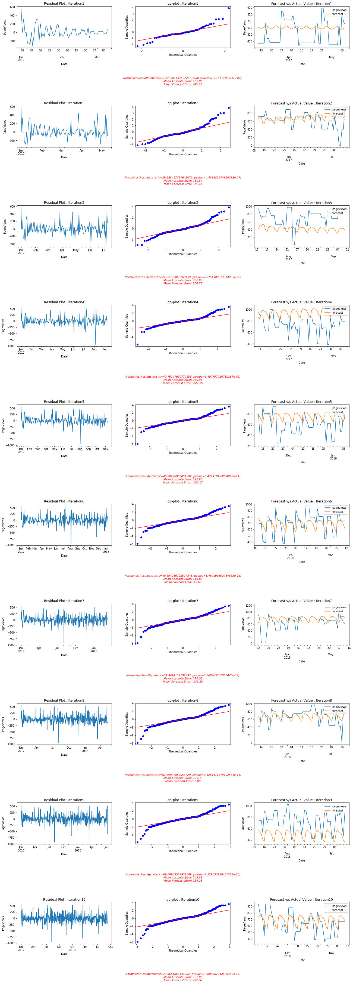

In [36]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(8)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

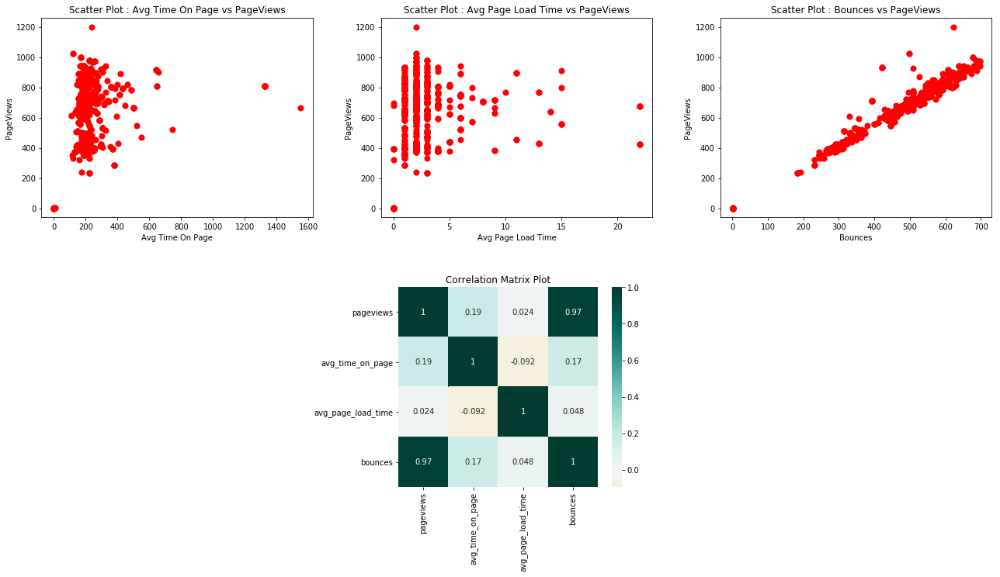

In [37]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(8)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: santamonicapd.org/dailyreports.aspx</center>

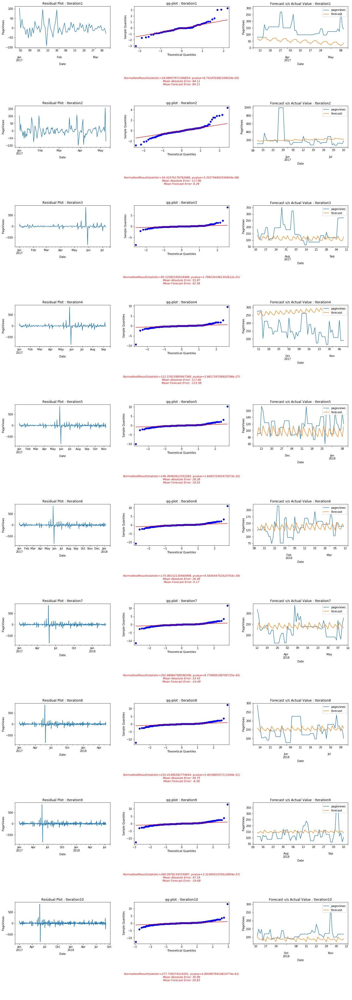

In [38]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(9)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

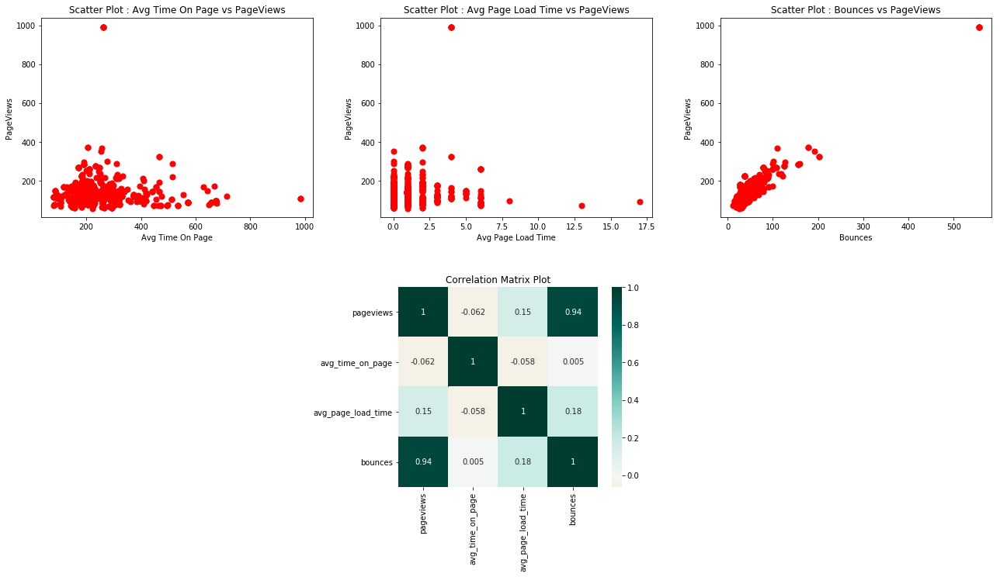

In [39]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(9)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/</center>

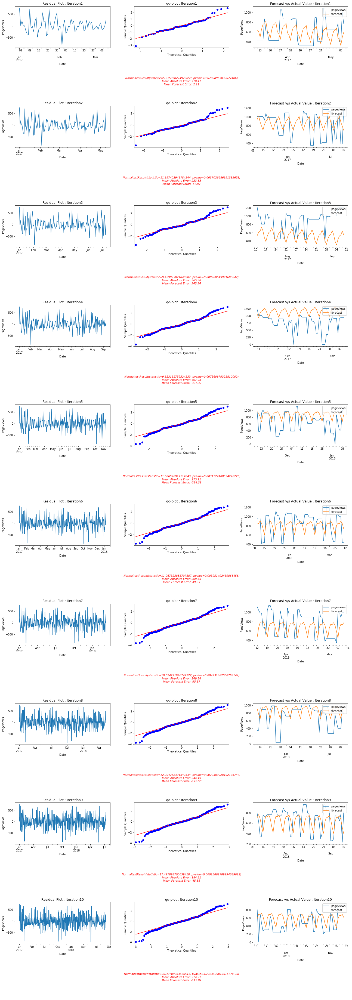

In [40]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(10)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

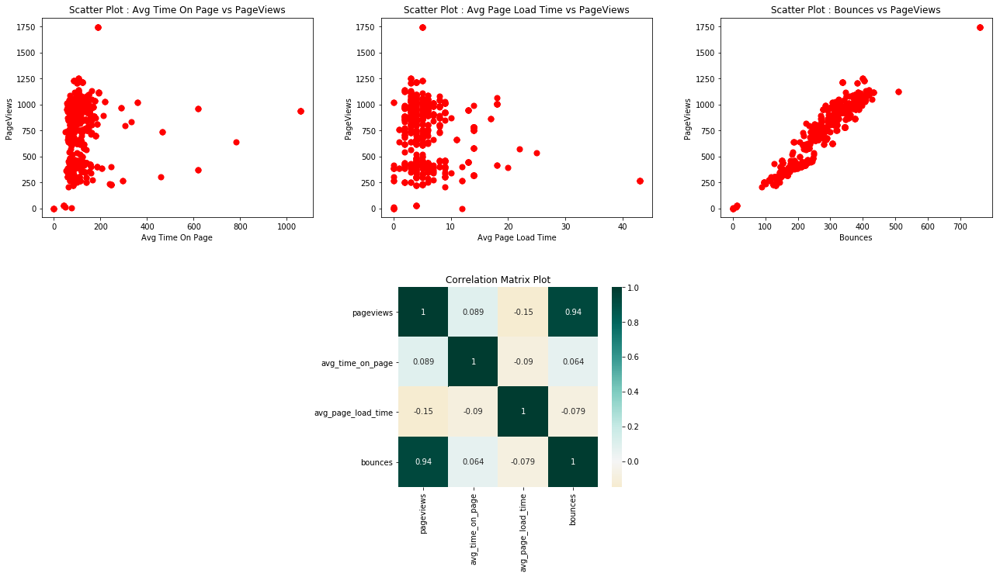

In [41]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(10)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/departments/ccs/</center>

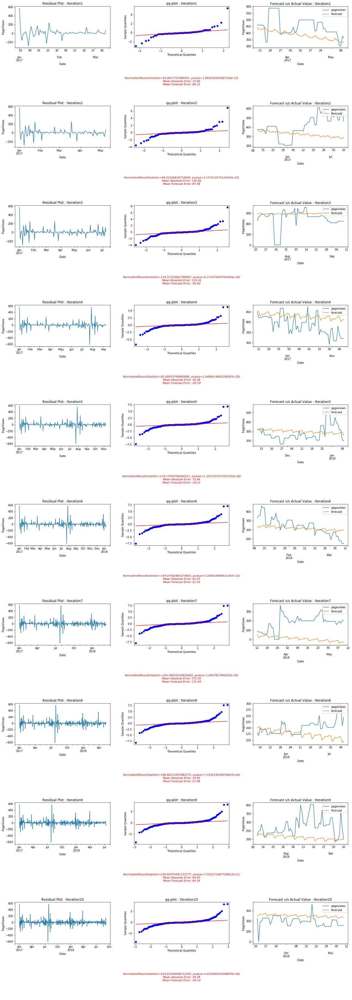

In [42]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(11)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

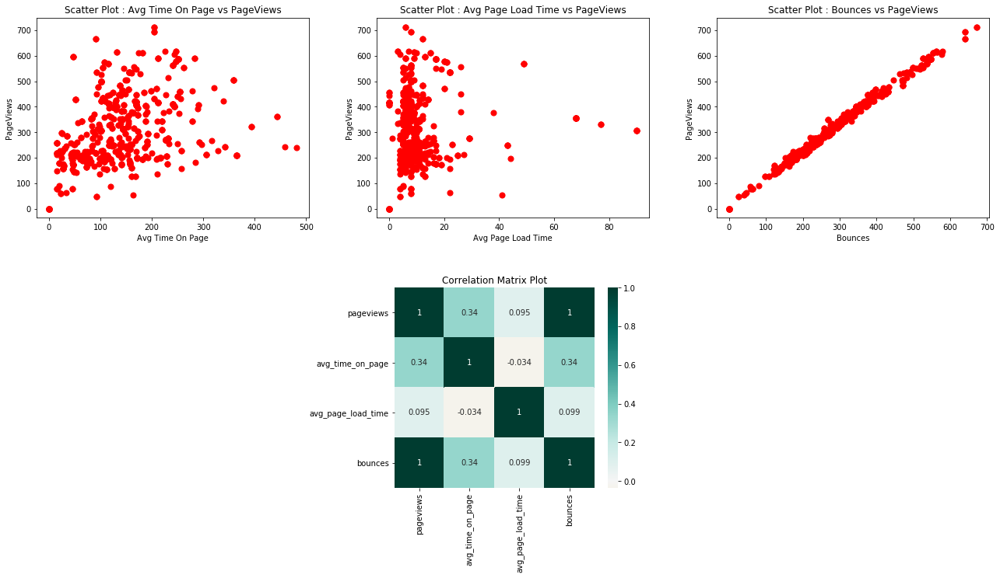

In [43]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(11)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/departments/hed/housing_and_redevelopment/housing/housing_division.aspx</center>

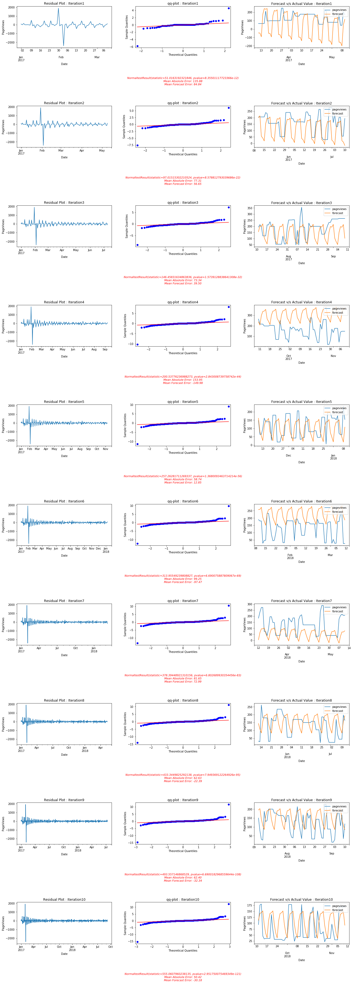

In [44]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(12)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

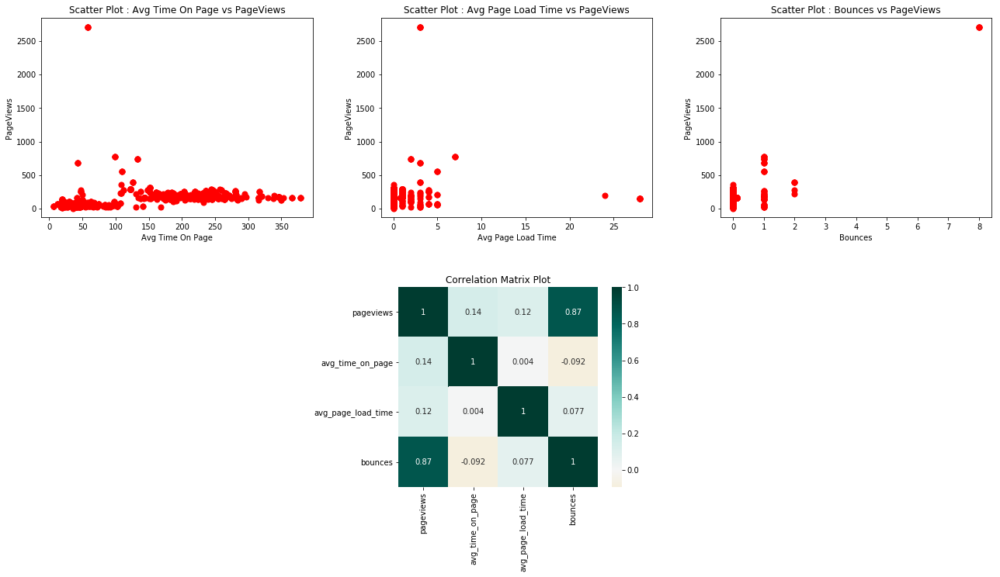

In [45]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(12)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/departments/hr/</center>

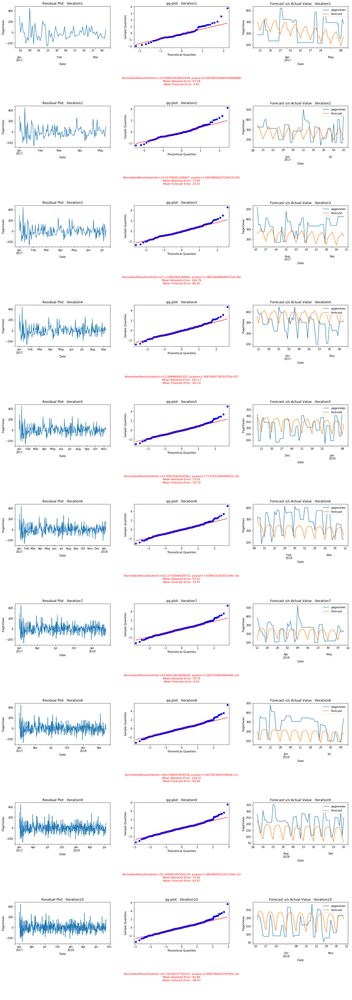

In [46]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(13)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

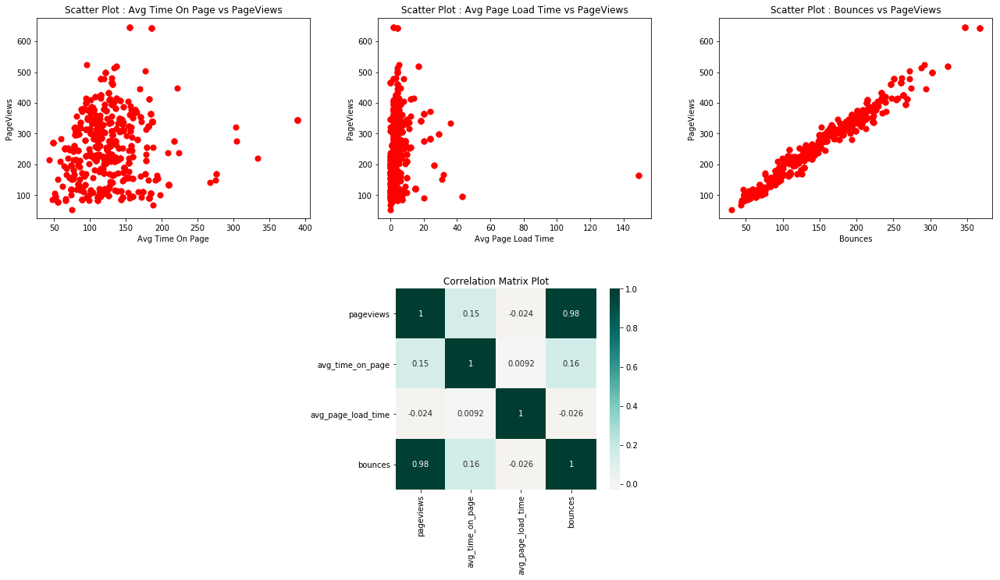

In [47]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(13)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/departments/pcd/permits/preferential-parking-permits/</center>

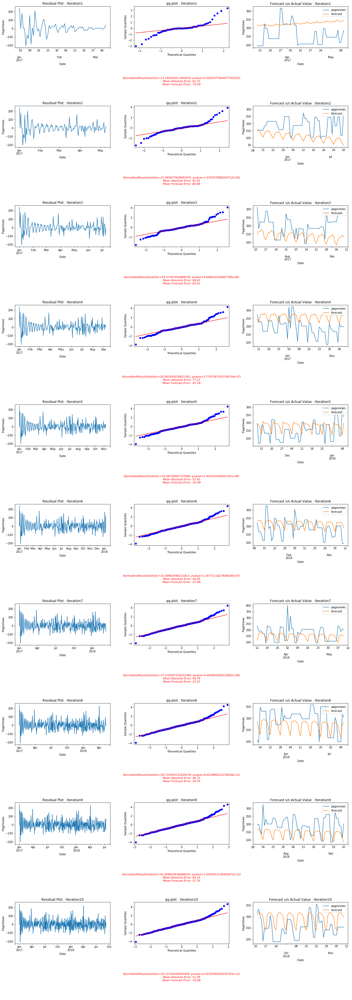

In [48]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(14)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

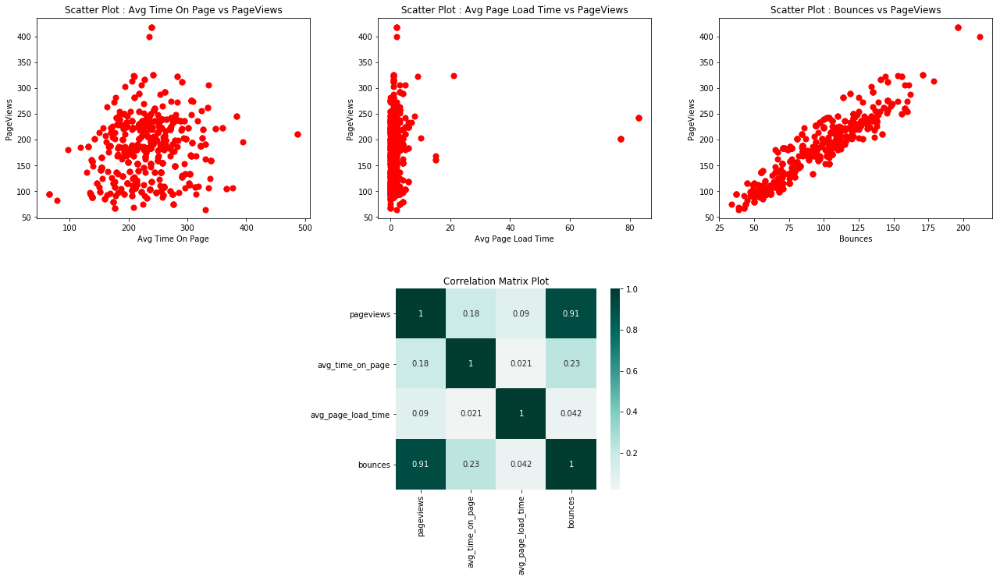

In [49]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(14)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/departments/pcd/transportation/motorists-parking/</center>

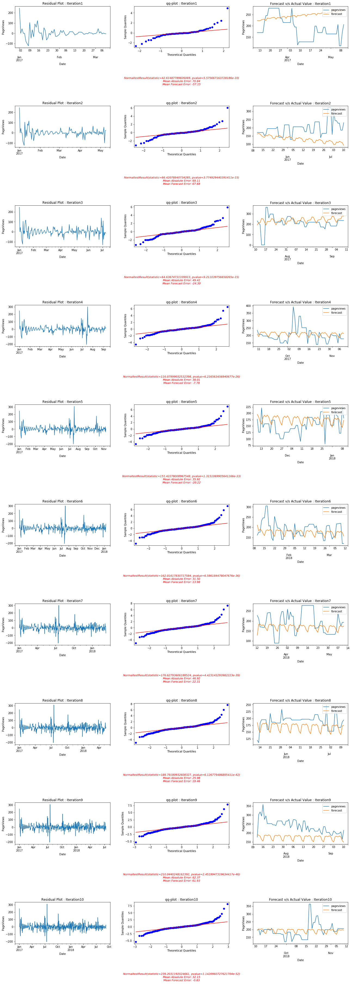

In [50]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(15)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

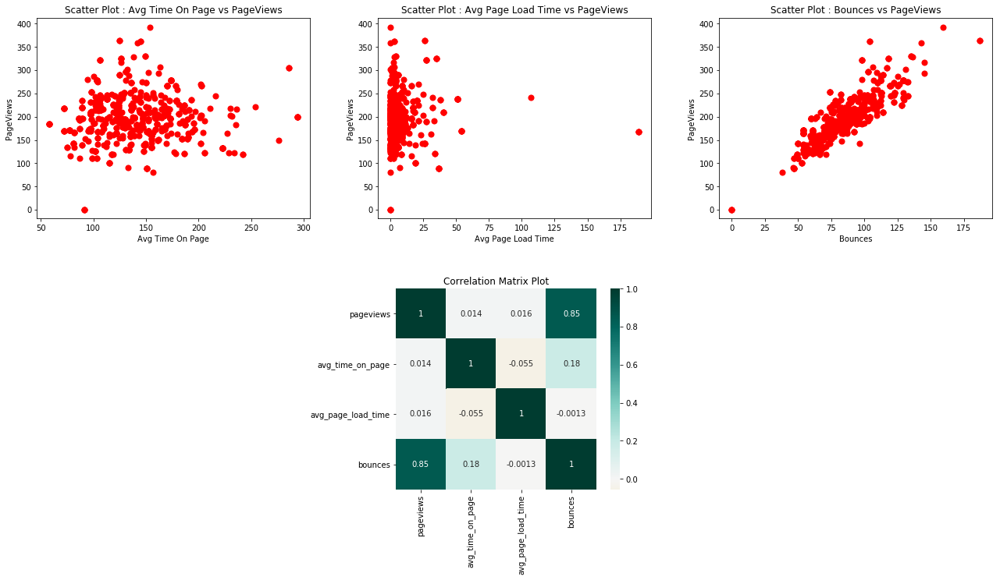

In [51]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(15)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/departments/pcd/transportation/motorists-parking/where-to-park/</center>

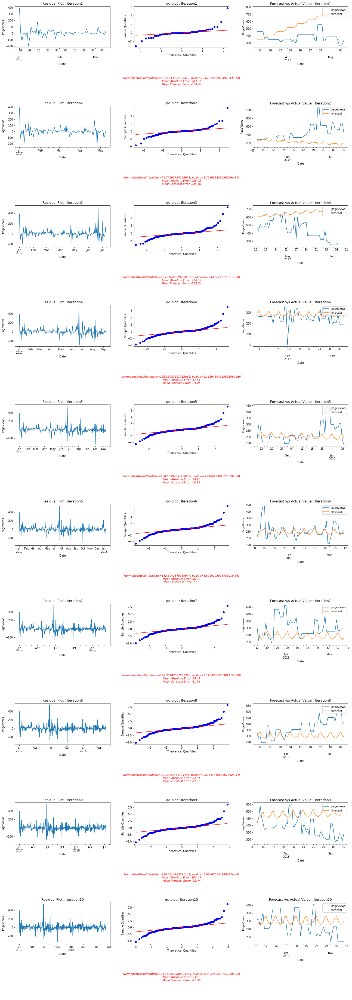

In [52]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(16)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

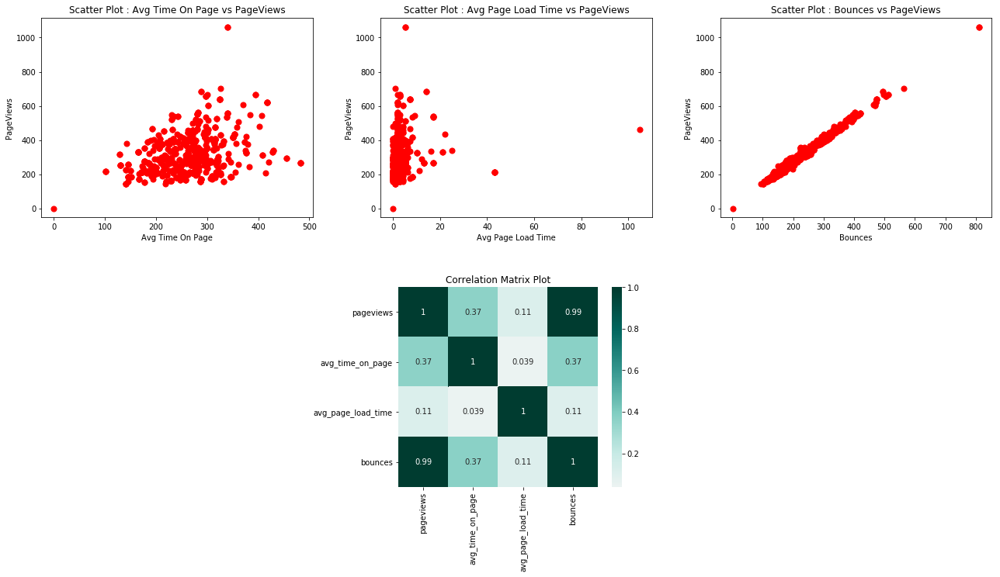

In [53]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(16)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/departments/rentcontrol/mar.aspx</center>

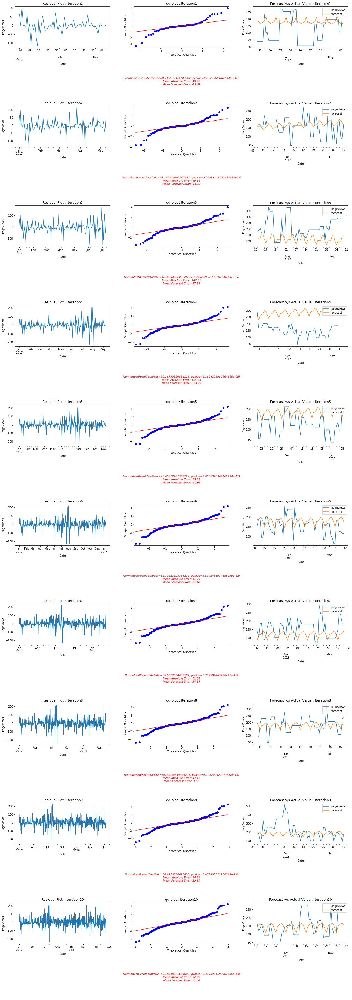

In [54]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(17)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

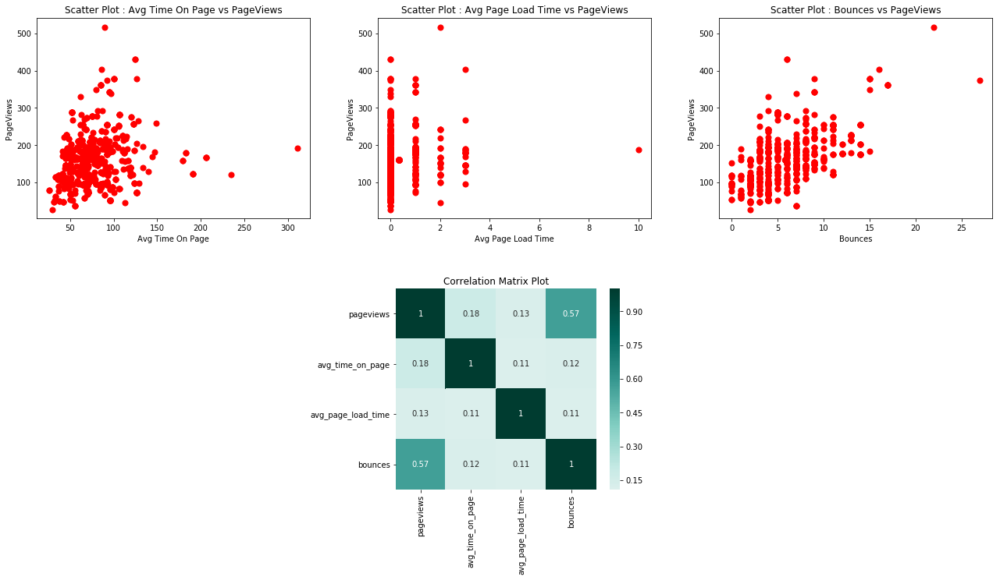

In [55]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(17)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smgov.net/portals/farmersmarket/</center>

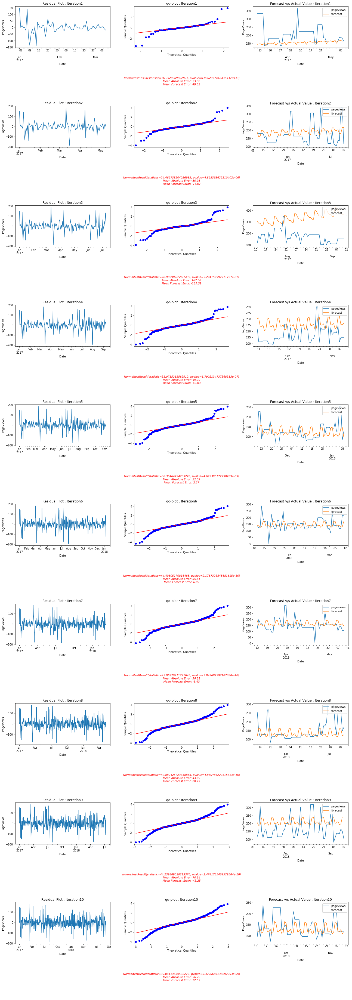

In [56]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(18)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

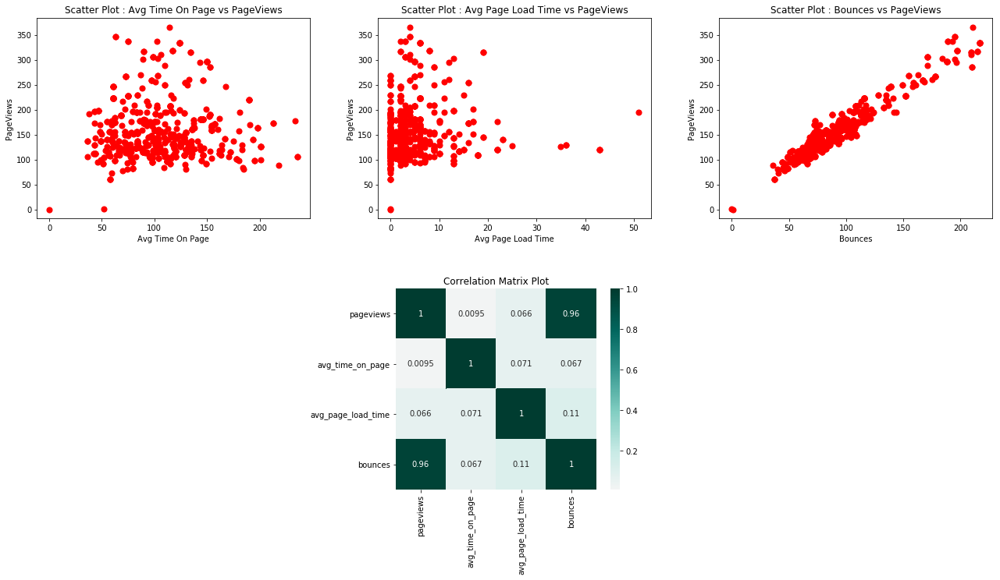

In [57]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(18)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### <center>Page URL: smpl.org/</center>

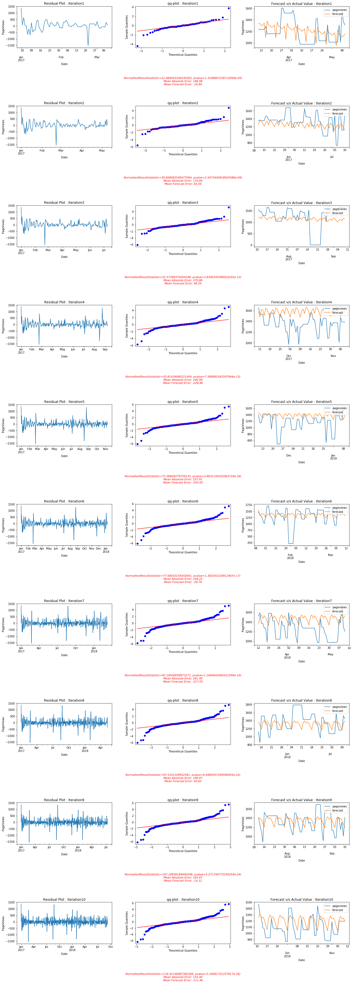

In [58]:
fig = plt.figure(figsize=[100,100])    
arima_time_series_modeling(19)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.20,wspace=0.25)    
plt.show()

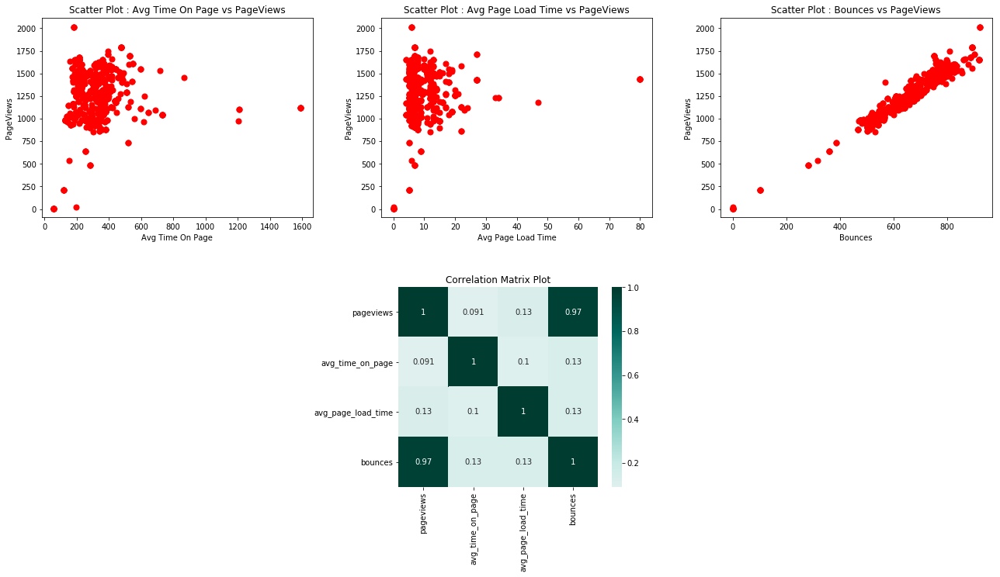

In [59]:
# Analysis of effect of confounding variables('avg_time_on_page','avg_page_load_time','bounces')
fig = plt.figure(figsize=[20,20])
scatterPlotConfoundingVariable(19)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.35,wspace=0.25)    
plt.show()

### Explanation of the time series plot of the top 20 web pages:<br>


We can see that the residuals generated from different cross validation iterations of the top 20 web pages come from normal distribution and are evenly distributed which can be viewed through a qq-plot.

### Explanation of relationship of confounding variables with PageViews of the top 20 web pages:<br>

1. <b>Relationship of 'Avg Time On Page' and 'PageViews':</b>

   We can see that there is a positive as well as negative correlation between Avg Time On Page and PageViews  
   indicating that when the Avg Time On Page increases the PageViews increases and decreases respectively.
   
   a. Possible reason for positive correlation between Avg Time On Page and PageViews is as follows:
   
   The web page has a lot of content relevant to the user which engages the user viewing the web page.This can also   
   motivate the user to view the page again in future thereby increasing the PageViews. 
   
   b. Possible reason for negative correlation between Avg Time On Page and PageViews is as follows:
   
   The web page doesn't have content relevant to the user which results in the bouncing of the user viewing the web 
   page to some other page. 
   
      
2. <b>Relationship of 'Avg Page Load Time' and 'PageViews':</b>

   We can see that there is a positive as well as negative correlation between Avg Page Load Time and PageViews  
   indicating that when the Avg Page Load Time increases the PageViews increases and decreases respectively.
   
   a. Possible reason for positive correlation between Avg Page Load Time and PageViews is as follows:
   
   The Web traffic analysis that we are performing is for government websites of Santa Monica which can have some 
   useful and important information for the users.Therefore, even if the Avg Page Load Time of the web page is high the 
   user will view that page thereby increasing the PageViews of that page.    
   
   b. Possible reason for negative correlation between Avg Page Load Time and PageViews is as follows:
   
   If the Avg Page Load Time value of the web page increases it will discourage the user from viewing that web page.  

   
3. <b>Relationship of 'Bounces' and 'PageViews':</b>

   We can see that there is a positive correlation between Bounces and PageViews indicating that when the PageViews 
   increase the Bounces also increase.Possible reasons for this are as follows:
   
   a. The user is redirected to this page from any top search result of search engines like Google.
   
   b. The user is redirected to this page from any other user relevant web page of the same website.
   
   c. The user is redirected to this page by clicking an advertisement on any other page.
   
   d. The bot is trying to access the web page.